In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2 as cv
import os
from os import path
import math
import re
import random

In [2]:
!apt-get install zip




zip is already the newest version (3.0-11build1).
0 upgraded, 0 newly installed, 0 to remove and 8 not upgraded.


In [3]:
if path.exists('/kaggle/working/output/')==False:
    os.mkdir('/kaggle/working/output/')

In [4]:
output_folder = '/kaggle/working/output/'

In [5]:
def gaussian_noise(image):
    noise = np.zeros((image.shape[0], image.shape[1]),dtype=np.uint8)
    cv.randn(noise, 128, 20)
    noise = (noise*random.uniform(0, 0.2)).astype(np.uint8)
    noise = cv.merge((noise,noise,noise))
    return noise

In [6]:
def uniform_noise(image):
    noise = np.zeros((image.shape[0], image.shape[1]),dtype=np.uint8)
    cv.randu(noise,0,255)
    noise = (noise*random.uniform(0, 0.2)).astype(np.uint8)
    noise = cv.merge((noise,noise,noise))
    return noise

In [7]:
def impulse_noise(image):
    noise = np.zeros((image.shape[0], image.shape[1]),dtype=np.uint8)
    ret,noise = cv.threshold(noise,250,255,cv.THRESH_BINARY)
    noise = (noise*random.uniform(0, 0.2)).astype(np.uint8)
    noise = cv.merge((noise,noise,noise))
    return noise

In [8]:
def add_noise(img):
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
  
    # Getting the dimensions of the image
    row , col = img.shape
      
    # Randomly pick some pixels in the
    # image for coloring them white
    # Pick a random number between 300 and 10000
    number_of_pixels = random.randint(300, 100_000)
    for i in range(number_of_pixels):
        
        # Pick a random y coordinate
        y_coord=random.randint(0, row - 1)
          
        # Pick a random x coordinate
        x_coord=random.randint(0, col - 1)
          
        # Colour that pixel to white
#         img[y_coord][x_coord] = 255
        
        if (i%random.randint(10,20)==0 and 5<y_coord<895 and 5<x_coord<1195):
            a = random.randint(0,5)
            b = random.randint(0,5)
            yy=0
            xx=0
            while yy<a and xx<b:
                y_new = y_coord+yy
                x_new = x_coord+xx
                if 0<y_new<900 and 0<x_new<1200:
                    img[y_new][x_new] = 255
                else:
                    break
                yy+=random.randint(-2,2)
                xx+=random.randint(-2,2)
        
          
    # Randomly pick some pixels in
    # the image for coloring them black
    # Pick a random number between 300 and 10000
    number_of_pixels = random.randint(300 , 100_000)
    for i in range(number_of_pixels):
        
        # Pick a random y coordinate
        y_coord=random.randint(0, row - 1)
          
        # Pick a random x coordinate
        x_coord=random.randint(0, col - 1)
          
        # Colour that pixel to black
#         img[y_coord][x_coord] = 0
        
        if (i%random.randint(10,20)==0 and 5<y_coord<895 and 5<x_coord<1195):
            a = random.randint(0,5)
            b = random.randint(0,5)
            yy=0
            xx=0
            while yy<a and xx<b:
                y_new = y_coord+yy
                x_new = x_coord+xx
                if 0<y_new<900 and 0<x_new<1200:
                    img[y_new][x_new] = 0
                else:
                    break
                yy+=random.randint(-2,2)
                xx+=random.randint(-2,2)
        
    img = img.astype(np.uint8)
    img = cv.merge((img,img,img))
    return img

In [9]:
def dilation(image, n=0):
    kernel= np.ones((3,3), np.uint8)
    if n==0:
        n = random.randint(2, 25)
    image_dilation = cv.dilate(image, kernel, iterations=n)
    return image_dilation,n

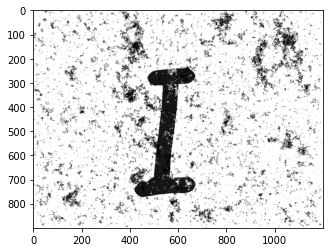

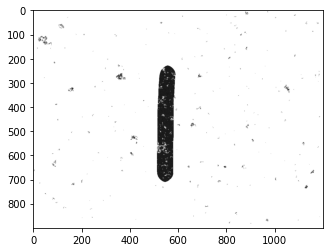

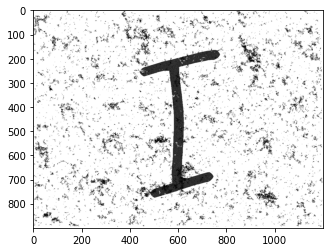

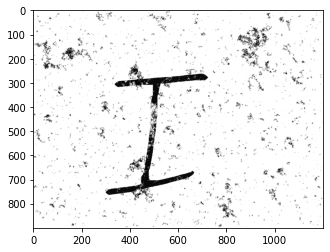

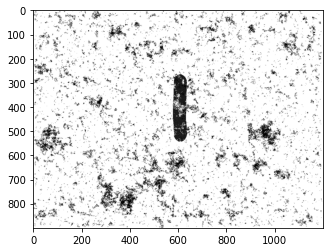

In [10]:
# Capital 1s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'1_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

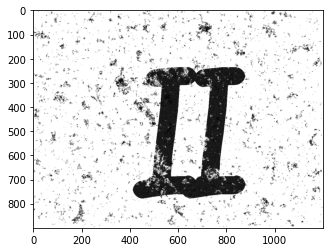

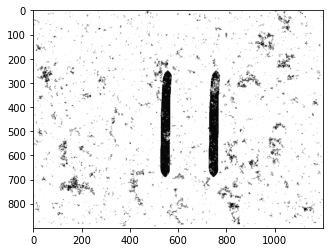

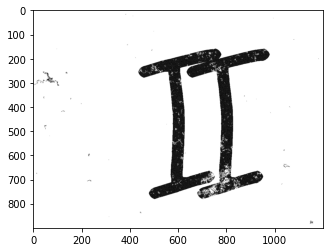

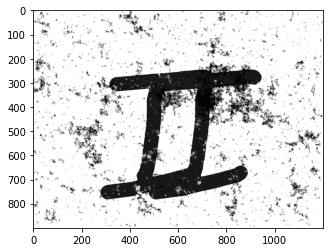

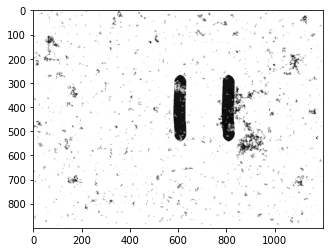

In [11]:
# Making capital 2s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
#     img_with_border = cv.copyMakeBorder(img, 0, 0, 300, 0, cv.BORDER_CONSTANT, value=[255,255,255])
#     cv.imshow('img',dst)
    dst2 = cv.rectangle(dst, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dil_img, 0.5, dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'2_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

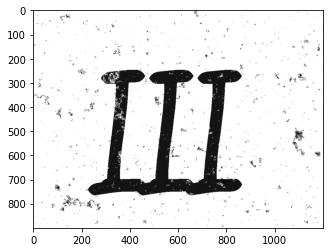

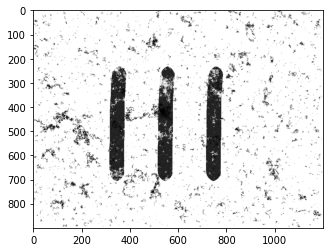

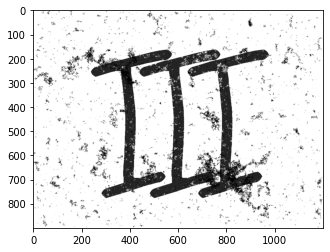

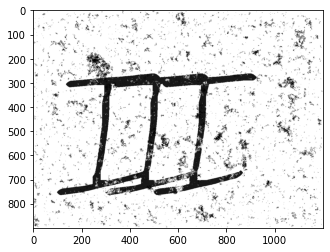

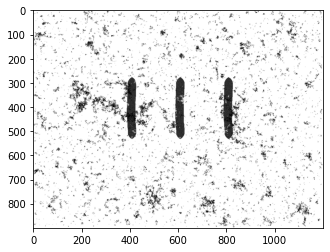

In [12]:
# Making capital 3s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = dil_img.shape[:2]
    M = np.float32([[1,0,200],[0,1,0]])
    M_M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    dst_dst = cv.warpAffine(dil_img,M_M,(cols,rows))
#     img_with_border = cv.copyMakeBorder(img, 0, 0, 300, 0, cv.BORDER_CONSTANT, value=[255,255,255])
#     cv.imshow('img',dst)
    dst2 = cv.rectangle(dst, (0,0), (200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst_dst, (1000,0), (1200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dil_img, 0.5, dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst2, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    noisy_image1 = cv.add(dst_dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'3_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

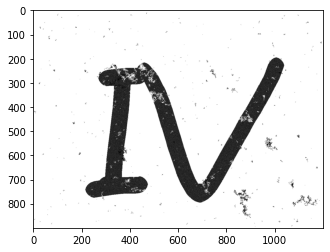

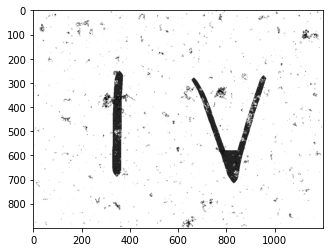

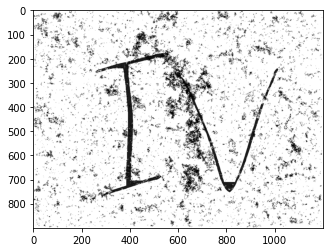

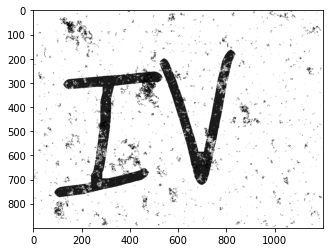

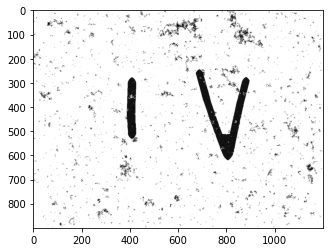

In [13]:
# Making capital 4s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'4_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

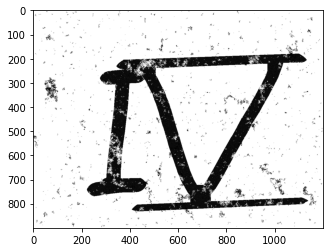

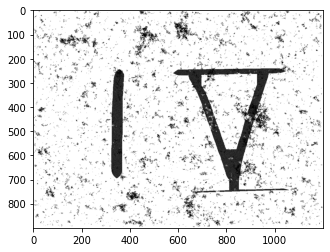

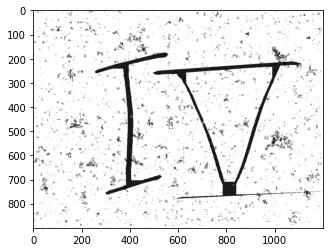

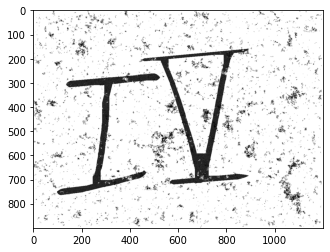

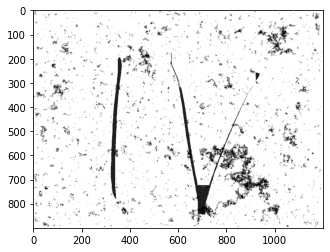

...

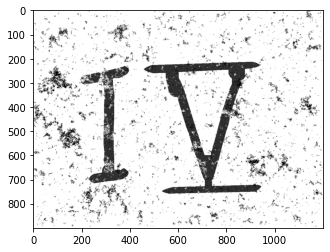

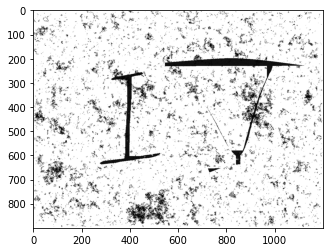

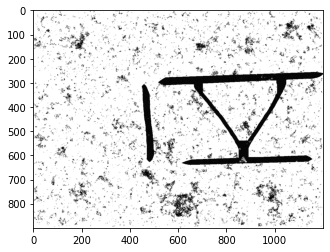

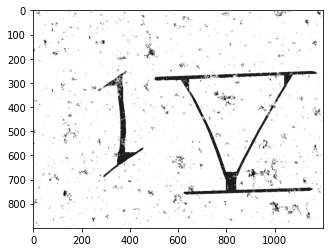

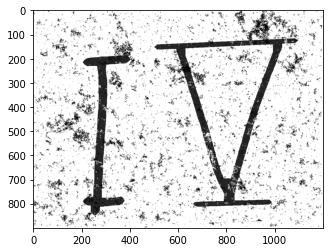

In [14]:
# Additional capital 4s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
        
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'4_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

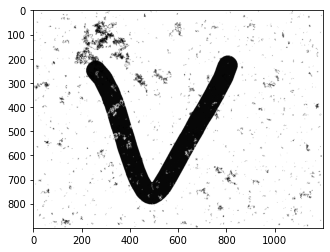

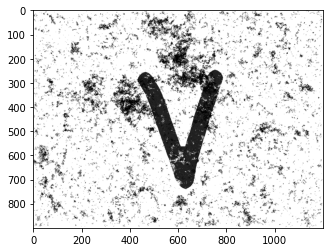

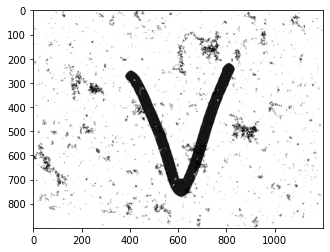

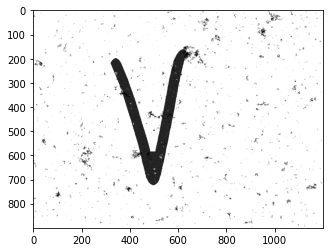

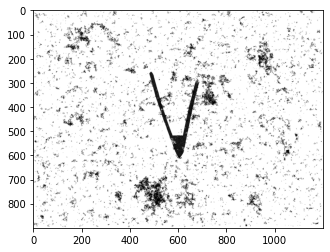

In [15]:
# Capital 5s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'5_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

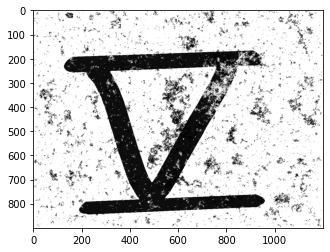

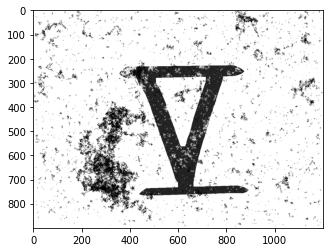

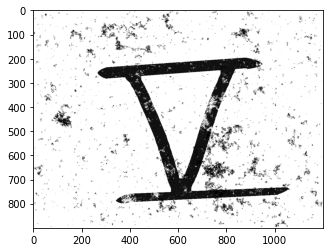

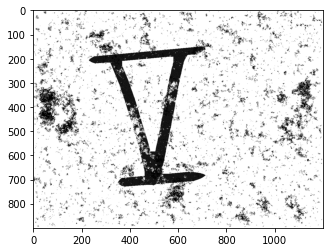

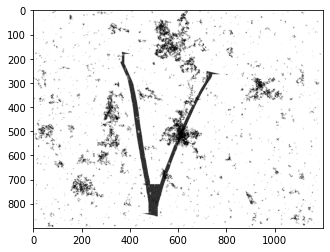

...

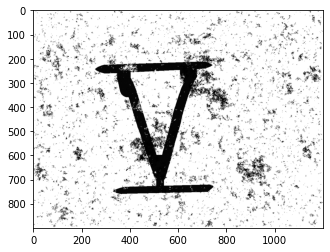

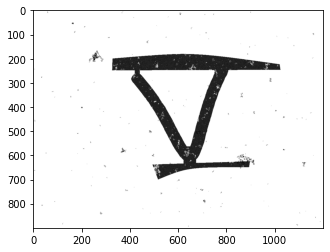

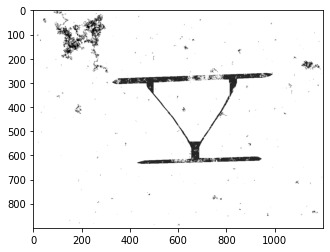

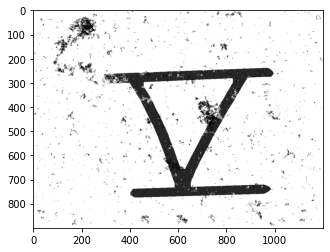

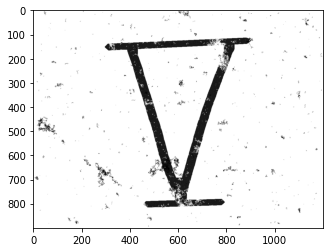

In [16]:
# Additional capital 5s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'5_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

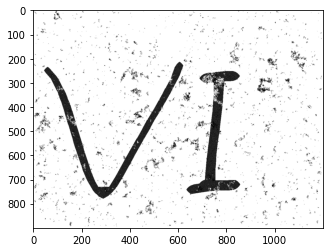

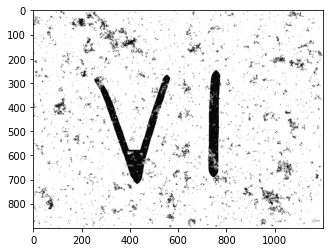

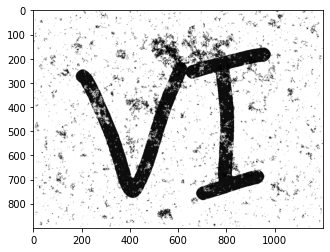

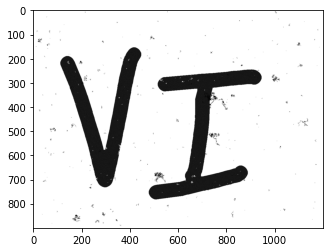

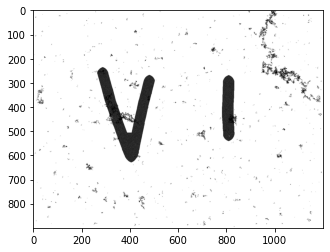

In [17]:
# Making capital 6s
i=1
while i<56:
    if i == 49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-400],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,0],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (800,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (-200,0), (200,900), (255,255,255), -1)
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
        cv.imwrite(os.path.join(output_folder, f'6_cap_{str(i)}.png'), dst3)
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'6_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

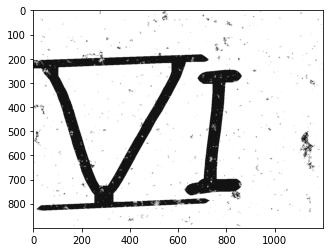

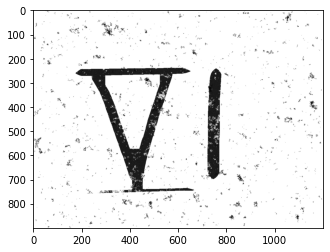

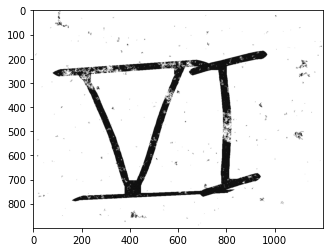

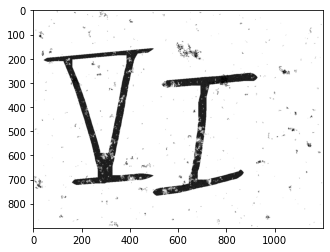

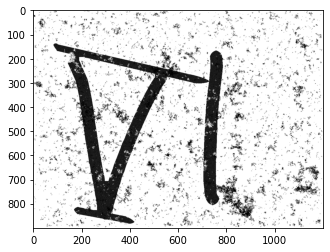

...

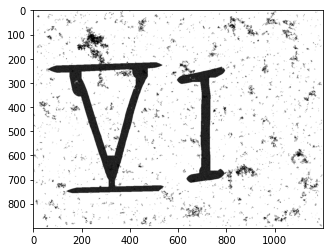

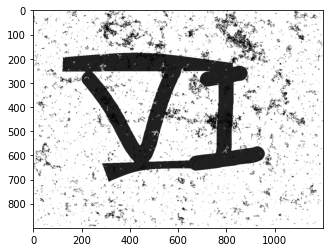

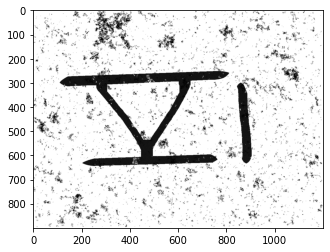

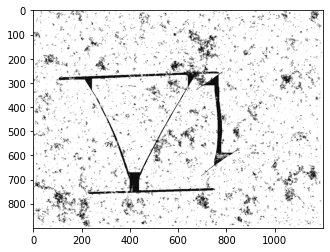

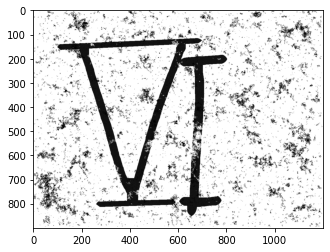

In [18]:
# Additional capital 6s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'6_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

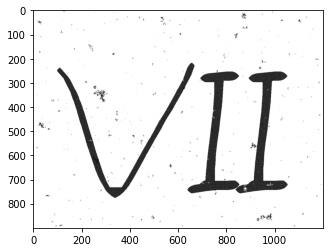

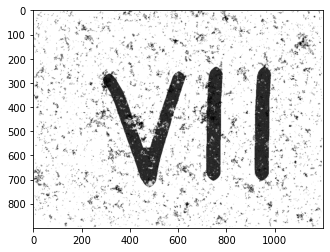

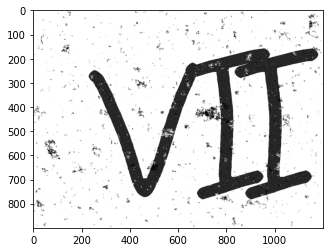

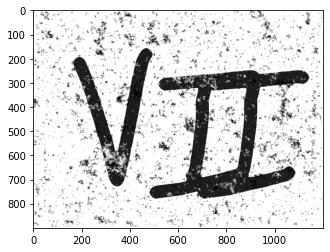

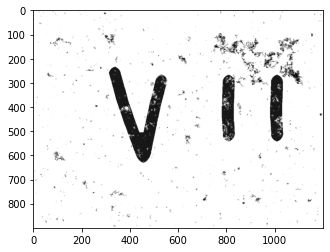

...

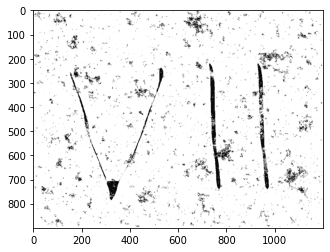

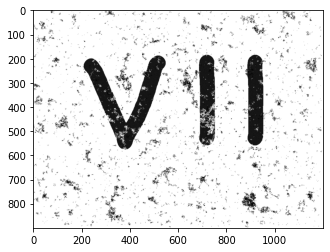

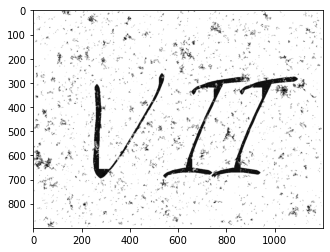

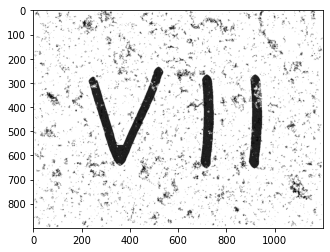

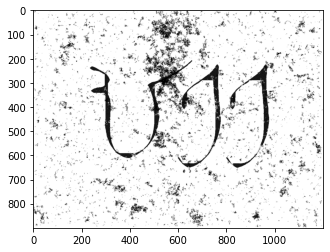

In [19]:
# Making capital 7s
i=1
while i<56:
    if i==49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-350],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,0],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
        M22 = np.float32([[1,0,200],[0,1,0]])
        dst22 = cv.warpAffine(img2,M22,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (800,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (-200,0), (200,900), (255,255,255), -1)
        dst_dst22 = cv.rectangle(dst22, (-200,0), (400,900), (255,255,255), -1)
    
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
    
        dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
        mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
        dst_dst3[mask2>0]=(0,0,0)
    
        cv.imwrite(os.path.join(output_folder, f'7_cap_{str(i)}.png'), dst_dst3)
        i+=1
        continue
        
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-150],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,400],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'7_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<56:
        plt.imshow(noisy)
        plt.show()
    i+=1

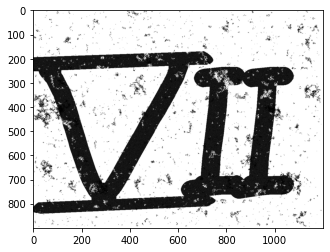

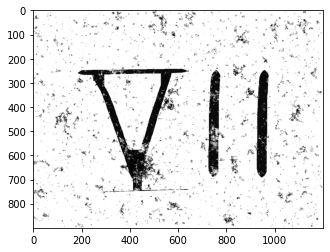

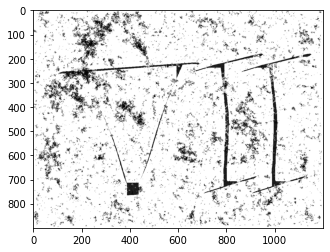

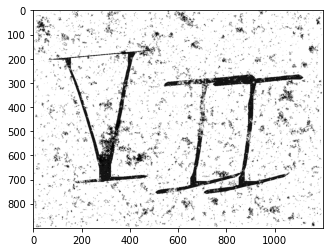

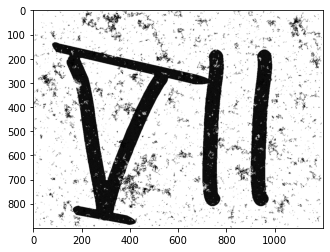

...

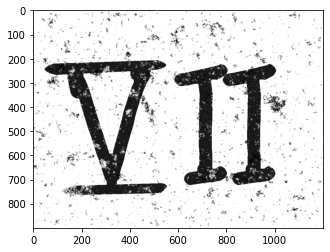

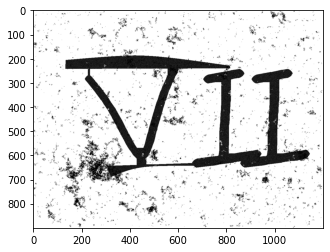

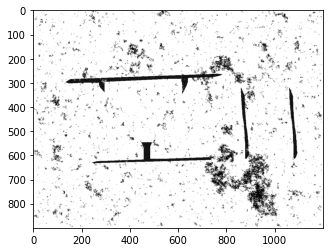

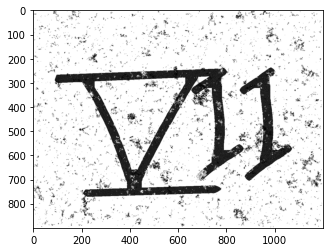

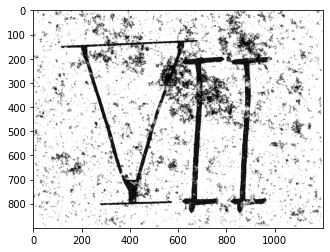

In [20]:
# Additional capital 7s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")    
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,400],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'7_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

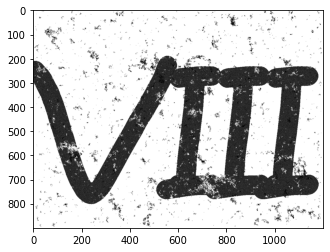

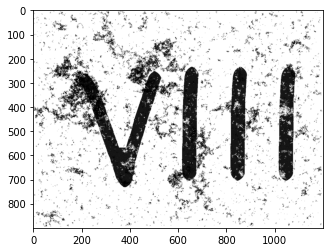

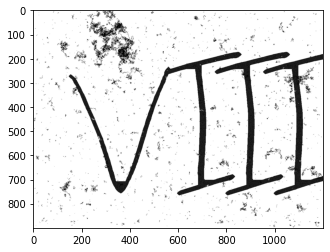

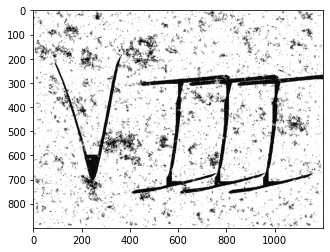

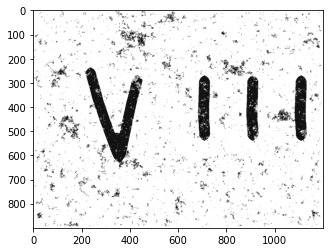

In [21]:
# Making capital 8s
i=1
while i<56:
    if i==49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-500],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,-150],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
        M22 = np.float32([[1,0,50],[0,1,0]])
        dst22 = cv.warpAffine(img2,M22,(cols,rows))
        M23 = np.float32([[1,0,250],[0,1,0]])
        dst23 = cv.warpAffine(img2,M23,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (700,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (1000,0), (1200,900), (255,255,255), -1)
        dst_dst22 = cv.rectangle(dst22, (-250,0), (400,900), (255,255,255), -1)
        dst_dst23 = cv.rectangle(dst23, (-250,0), (600,900), (255,255,255), -1)
    
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
    
        dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
        mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
        dst_dst3[mask2>0]=(0,0,0)
    
        dst_dst4 = cv.addWeighted(dst_dst3, 0.5, dst_dst23, 0.5, 0.0)
        mask3=cv.inRange(dst_dst4,(0,0,0),(130,130,130))
        dst_dst4[mask3>0]=(0,0,0)
    
        cv.imwrite(os.path.join(output_folder, f'8_cap_{str(i)}.png'), dst_dst4)
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-250],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,100],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,300],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    M23 = np.float32([[1,0,500],[0,1,0]])
    dst23 = cv.warpAffine(dil_img2,M23,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (950,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    dst_dst23 = cv.rectangle(dst23, (0,0), (600,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    dst_dst4 = cv.addWeighted(dst_dst3, 0.5, dst_dst23, 0.5, 0.0)
    mask3=cv.inRange(dst_dst4,(0,0,0),(130,130,130))
    dst_dst4[mask3>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst4,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'8_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

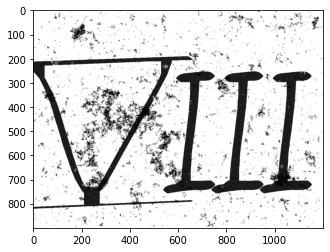

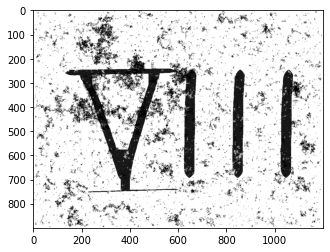

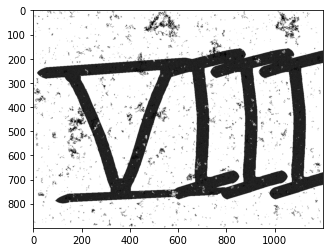

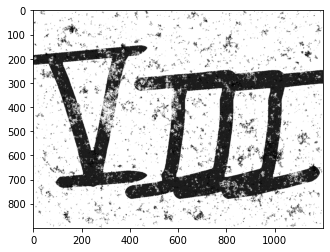

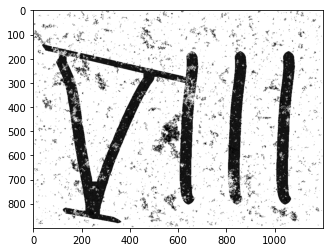

...

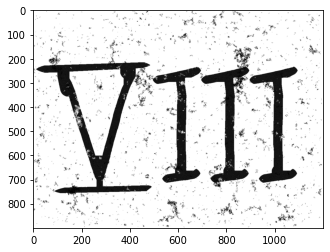

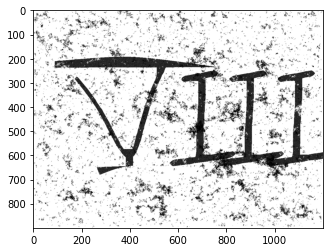

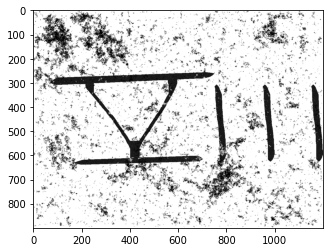

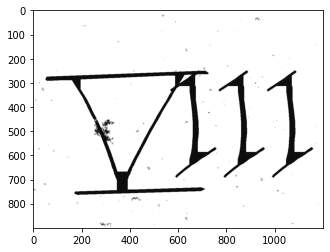

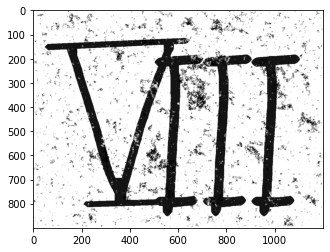

In [22]:
# Additional capital 8s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img032-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-250],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,100],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,300],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    M23 = np.float32([[1,0,500],[0,1,0]])
    dst23 = cv.warpAffine(dil_img2,M23,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (950,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    dst_dst23 = cv.rectangle(dst23, (0,0), (600,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    dst_dst4 = cv.addWeighted(dst_dst3, 0.5, dst_dst23, 0.5, 0.0)
    mask3=cv.inRange(dst_dst4,(0,0,0),(130,130,130))
    dst_dst4[mask3>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst4,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'8_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

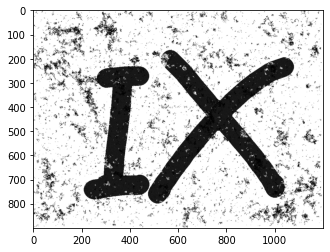

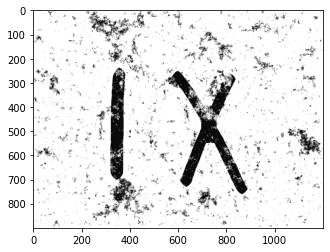

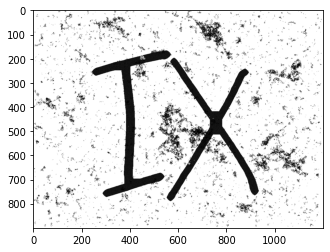

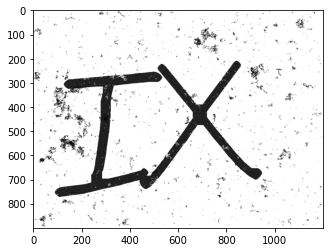

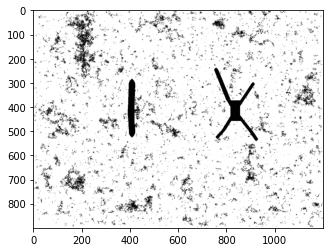

In [23]:
# Making capital 9s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'9_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

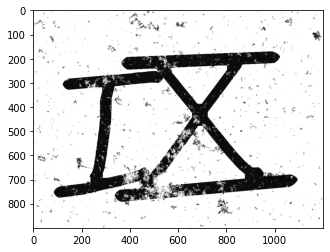

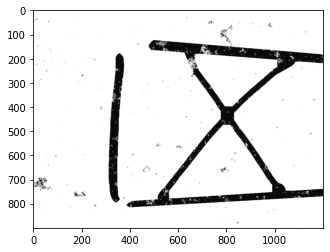

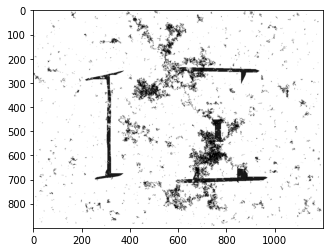

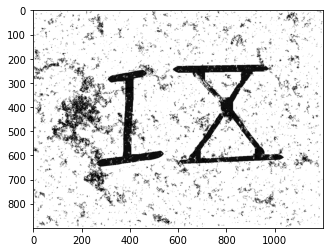

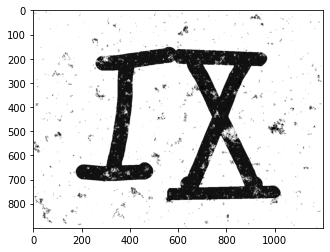

...

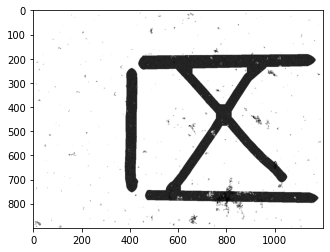

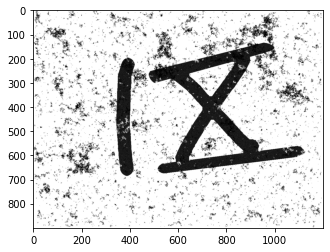

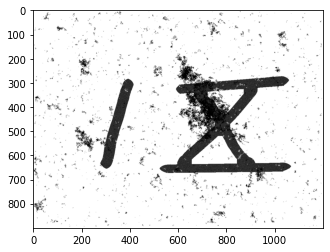

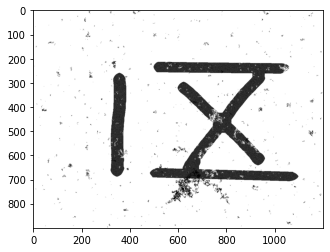

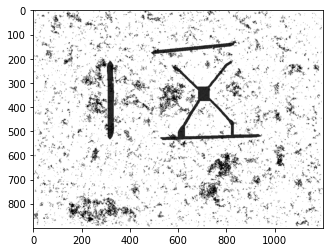

In [24]:
# Additional capital 9s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
        
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img019-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'9_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

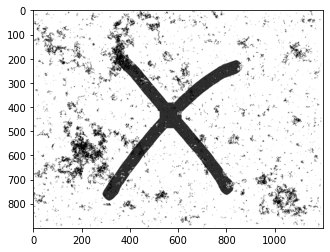

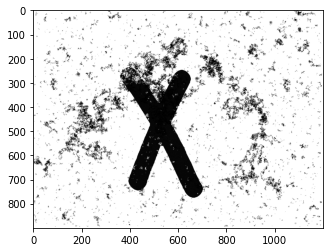

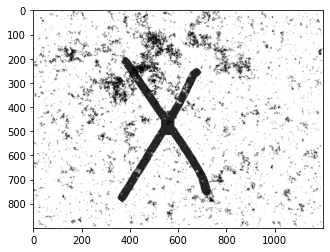

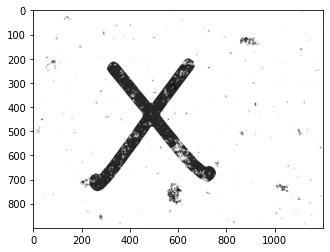

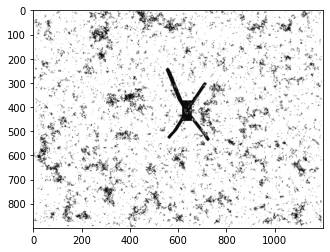

In [25]:
# Capital 10s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'10_cap_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

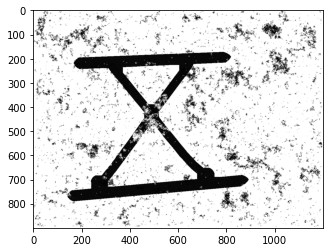

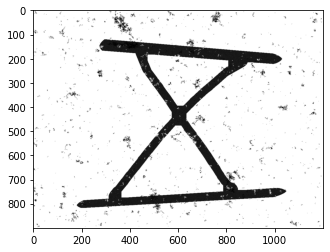

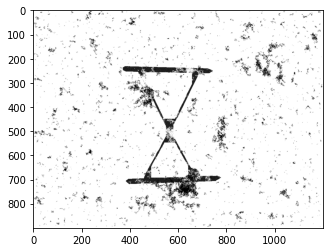

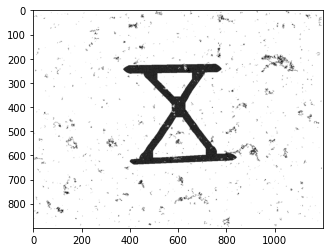

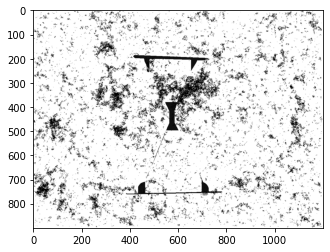

...

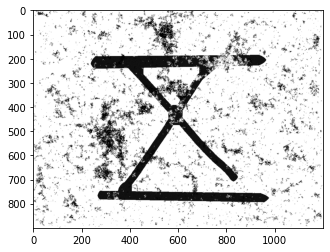

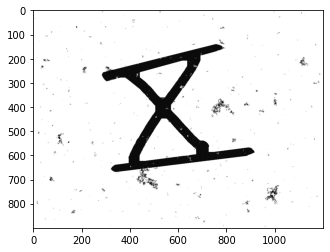

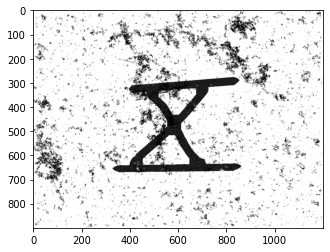

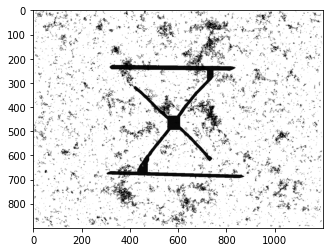

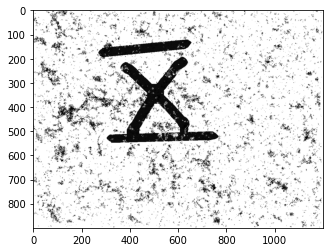

In [26]:
# Additional capital 10s
i=1
while i<56:
    if path.exists(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}"
                    +' - Copy'+".png")==False:
        i+=1
        continue
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img034-{str(i).zfill(3)}"
                    +' - Copy'+".png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'10_cap_copy_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    plt.imshow(noisy)
    plt.show()
    i+=1

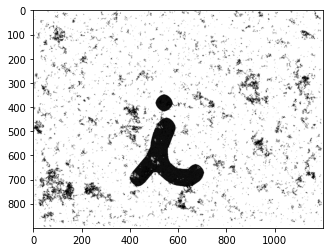

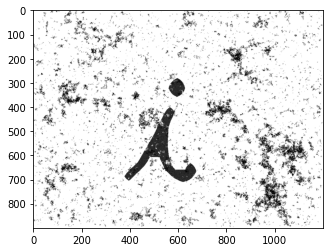

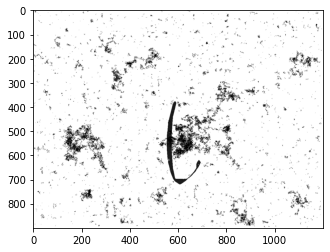

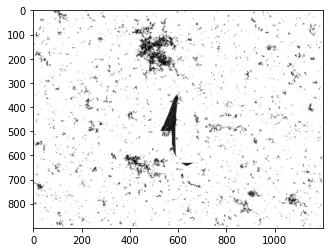

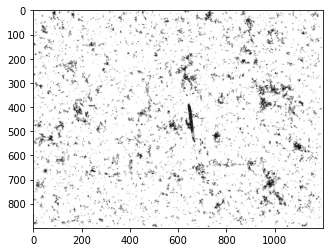

In [27]:
# Small 1s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'1_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

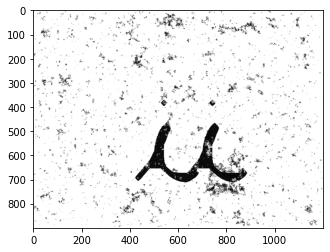

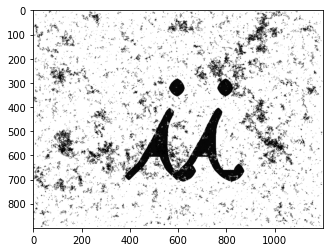

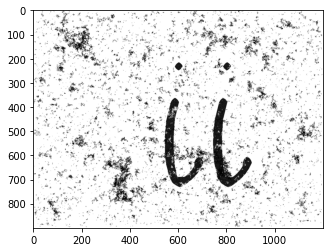

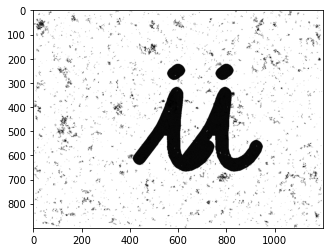

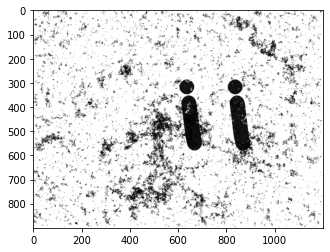

In [28]:
# Making small 2s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
#     img_with_border = cv.copyMakeBorder(img, 0, 0, 300, 0, cv.BORDER_CONSTANT, value=[255,255,255])
#     cv.imshow('img',dst)
    dst2 = cv.rectangle(dst, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dil_img, 0.5, dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'2_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

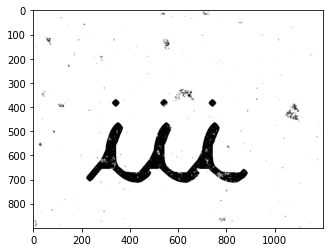

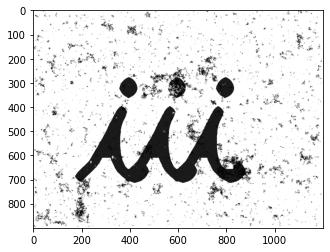

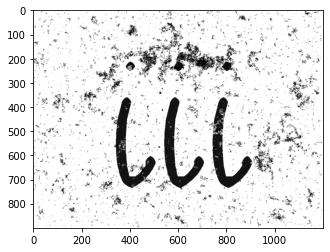

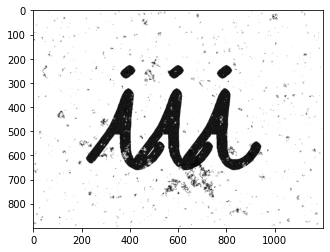

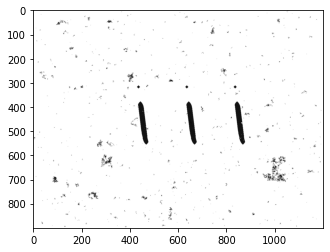

In [29]:
# Making small 3s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,200],[0,1,0]])
    M_M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    dst_dst = cv.warpAffine(dil_img,M_M,(cols,rows))
#     img_with_border = cv.copyMakeBorder(img, 0, 0, 300, 0, cv.BORDER_CONSTANT, value=[255,255,255])
#     cv.imshow('img',dst)
    dst2 = cv.rectangle(dst, (0,0), (200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst_dst, (1000,0), (1200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dil_img, 0.5, dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst2, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    noisy_image1 = cv.add(dst_dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'3_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

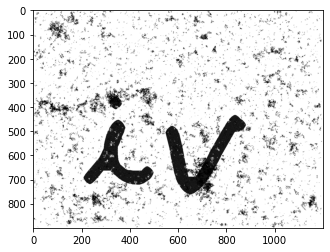

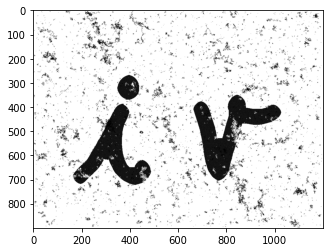

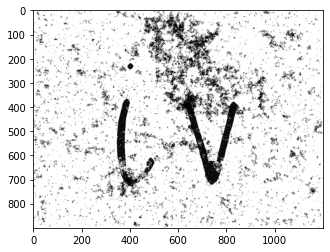

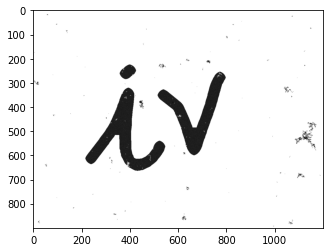

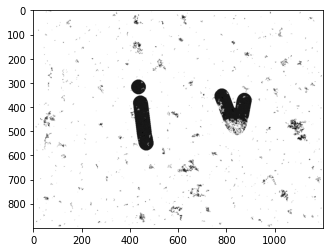

In [30]:
# Making small 4s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'4_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

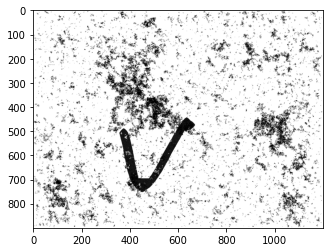

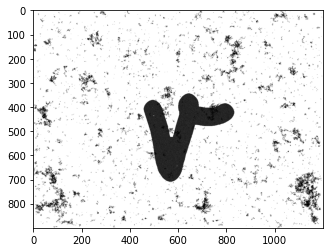

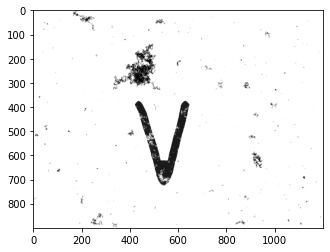

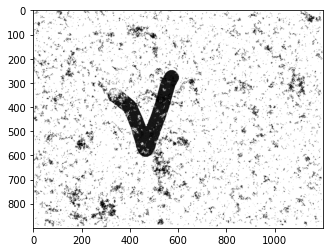

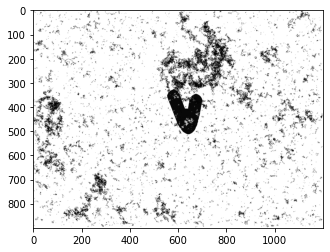

In [31]:
# Small 5s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'5_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

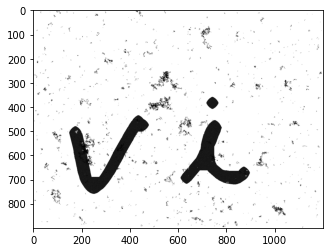

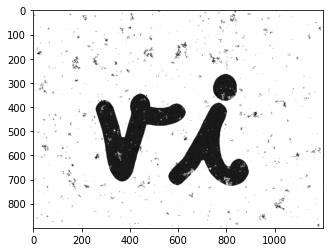

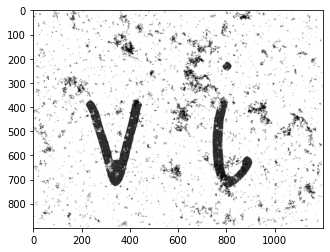

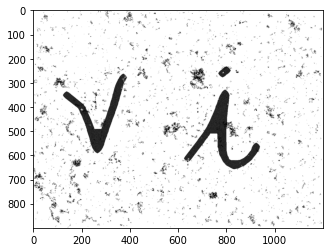

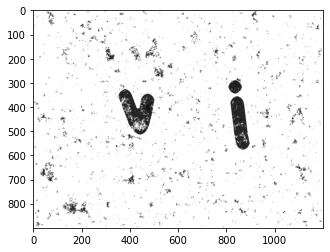

In [32]:
# Making small 6s
i=1
while i<56:
    if i == 49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-400],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,0],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (800,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (-200,0), (200,900), (255,255,255), -1)
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
        cv.imwrite(os.path.join(output_folder, f'6_small_{str(i)}.png'), dst3)
        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'6_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

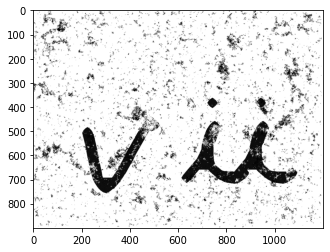

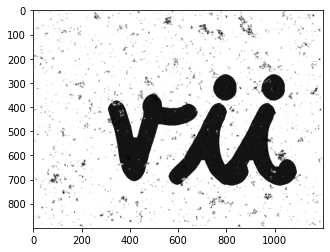

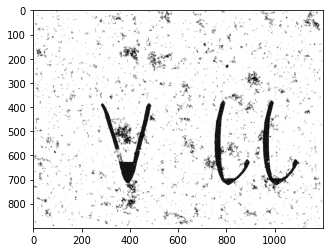

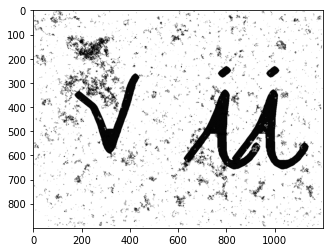

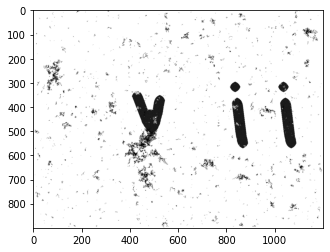

In [33]:
# Making small 7s
i=1
while i<56:
    if i==49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-350],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,0],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
        M22 = np.float32([[1,0,200],[0,1,0]])
        dst22 = cv.warpAffine(img2,M22,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (800,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (-200,0), (200,900), (255,255,255), -1)
        dst_dst22 = cv.rectangle(dst22, (-200,0), (400,900), (255,255,255), -1)
    
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
    
        dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
        mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
        dst_dst3[mask2>0]=(0,0,0)
    
        cv.imwrite(os.path.join(output_folder, f'7_small_{str(i)}.png'), dst_dst3)
        i+=1
        continue
        
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-150],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,400],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'7_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

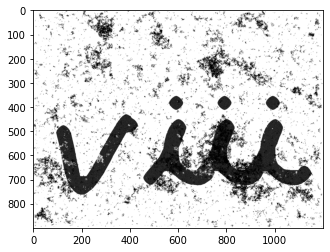

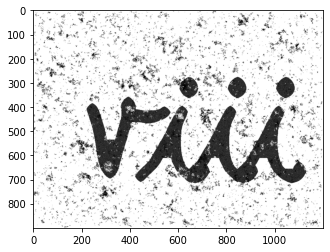

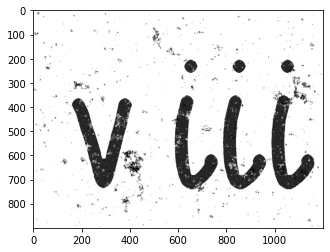

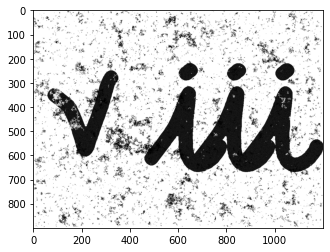

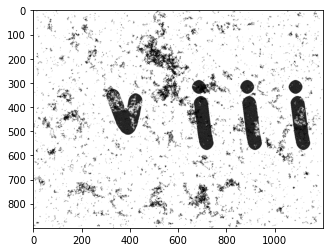

In [34]:
# Making small 8s
i=1
while i<56:
    if i==49:
        img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
        rows,cols = img.shape[:2]
        M = np.float32([[1,0,-500],[0,1,0]])
        dst = cv.warpAffine(img,M,(cols,rows))
    
        img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
        M2 = np.float32([[1,0,-150],[0,1,0]])
        dst2 = cv.warpAffine(img2,M2,(cols,rows))
        M22 = np.float32([[1,0,50],[0,1,0]])
        dst22 = cv.warpAffine(img2,M22,(cols,rows))
        M23 = np.float32([[1,0,250],[0,1,0]])
        dst23 = cv.warpAffine(img2,M23,(cols,rows))
    
        dst_dst = cv.rectangle(dst, (700,0), (1200,900), (255,255,255), -1)
        dst_dst2 = cv.rectangle(dst2, (1000,0), (1200,900), (255,255,255), -1)
        dst_dst22 = cv.rectangle(dst22, (-250,0), (400,900), (255,255,255), -1)
        dst_dst23 = cv.rectangle(dst23, (-250,0), (600,900), (255,255,255), -1)
    
        dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
        mask=cv.inRange(dst3,(0,0,0),(130,130,130))
        dst3[mask>0]=(0,0,0)
    
        dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
        mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
        dst_dst3[mask2>0]=(0,0,0)
    
        dst_dst4 = cv.addWeighted(dst_dst3, 0.5, dst_dst23, 0.5, 0.0)
        mask3=cv.inRange(dst_dst4,(0,0,0),(130,130,130))
        dst_dst4[mask3>0]=(0,0,0)
    
        cv.imwrite(os.path.join(output_folder, f'8_small_{str(i)}.png'), dst_dst4)

        i+=1
        continue
    
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img058-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-250],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,50],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    M22 = np.float32([[1,0,250],[0,1,0]])
    dst22 = cv.warpAffine(dil_img2,M22,(cols,rows))
    M23 = np.float32([[1,0,450],[0,1,0]])
    dst23 = cv.warpAffine(dil_img2,M23,(cols,rows))
    
    dst_dst = cv.rectangle(dst, (950,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst_dst22 = cv.rectangle(dst22, (0,0), (400,900), (255,255,255), -1)
    dst_dst23 = cv.rectangle(dst23, (0,0), (600,900), (255,255,255), -1)
    
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    
    dst_dst3 = cv.addWeighted(dst3, 0.5, dst_dst22, 0.5, 0.0)
    mask2=cv.inRange(dst_dst3,(0,0,0),(130,130,130))
    dst_dst3[mask2>0]=(0,0,0)
    
    dst_dst4 = cv.addWeighted(dst_dst3, 0.5, dst_dst23, 0.5, 0.0)
    mask3=cv.inRange(dst_dst4,(0,0,0),(130,130,130))
    dst_dst4[mask3>0]=(0,0,0)
    
    noisy_image1 = cv.add(dst_dst4,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    
    cv.imwrite(os.path.join(output_folder, f'8_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

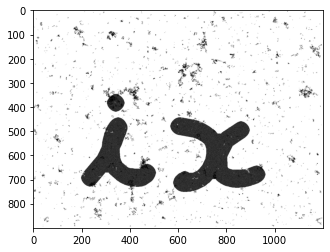

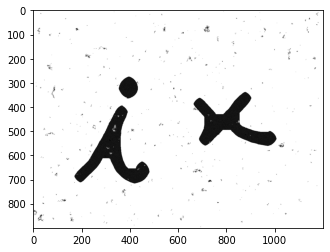

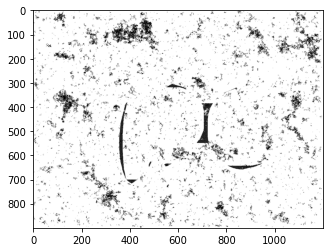

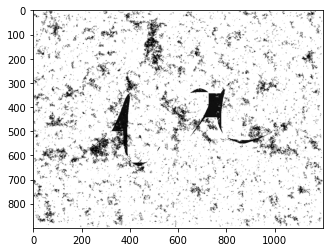

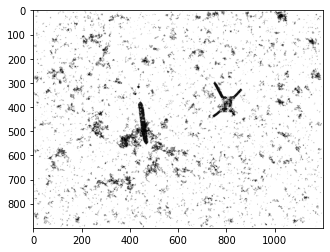

In [35]:
# Making small 9s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img045-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,-200],[0,1,0]])
    dst = cv.warpAffine(dil_img,M,(cols,rows))
    img2 = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img060-{str(i).zfill(3)}.png")
    dil_img2,n = dilation(img2,n)
    M2 = np.float32([[1,0,200],[0,1,0]])
    dst2 = cv.warpAffine(dil_img2,M2,(cols,rows))
    dst_dst = cv.rectangle(dst, (1000,0), (1200,900), (255,255,255), -1)
    dst_dst2 = cv.rectangle(dst2, (0,0), (200,900), (255,255,255), -1)
    dst3 = cv.addWeighted(dst_dst, 0.5, dst_dst2, 0.5, 0.0)
    mask=cv.inRange(dst3,(0,0,0),(130,130,130))
    dst3[mask>0]=(0,0,0)
    noisy_image1 = cv.add(dst3,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'9_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

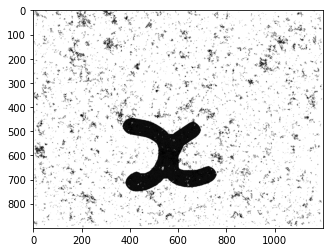

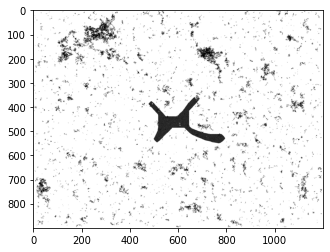

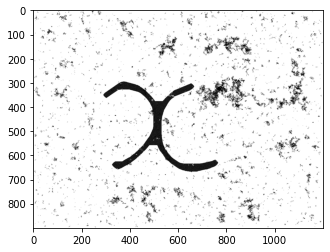

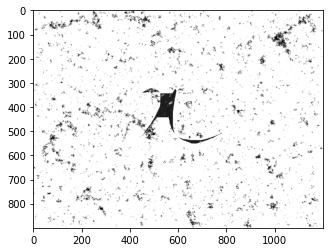

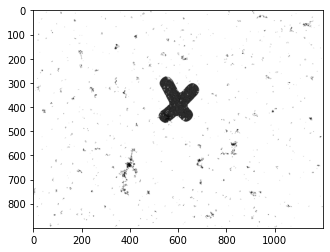

In [36]:
# Small 10s
i=1
while i<56:
    img = cv.imread(f"../input/english-handwritten-characters-modified/English Handwritten Characters Modified/img060-{str(i).zfill(3)}.png")
    dil_img,n = dilation(img)
    noisy_image1 = cv.add(dil_img,gaussian_noise(img))
    noisy_image2 = cv.add(noisy_image1,uniform_noise(img))
    noisy_image3 = cv.add(noisy_image2,impulse_noise(img))
    noisy = add_noise(noisy_image3)
    cv.imwrite(os.path.join(output_folder, f'10_small_{str(i)}.png'), noisy,  [cv.IMWRITE_PNG_COMPRESSION, 9])
    if i<6:
        plt.imshow(noisy)
        plt.show()
    i+=1

In [37]:
!zip -r output.zip /kaggle/working/output/

  adding: kaggle/working/output/ (stored 0%)
  adding: kaggle/working/output/8_small_54.png (deflated 0%)
  adding: kaggle/working/output/3_cap_55.png (deflated 3%)
  adding: kaggle/working/output/4_cap_42.png (deflated 0%)
  adding: kaggle/working/output/8_cap_copy_14.png (deflated 0%)
  adding: kaggle/working/output/8_cap_35.png (deflated 0%)
  adding: kaggle/working/output/2_cap_31.png (deflated 0%)
  adding: kaggle/working/output/4_small_32.png (deflated 1%)
  adding: kaggle/working/output/8_small_35.png (deflated 0%)
  adding: kaggle/working/output/6_cap_38.png (deflated 1%)
  adding: kaggle/working/output/3_cap_21.png (deflated 0%)
  adding: kaggle/working/output/10_cap_19.png (deflated 0%)
  adding: kaggle/working/output/5_small_48.png (deflated 2%)
  adding: kaggle/working/output/8_small_26.png (deflated 0%)
  adding: kaggle/working/output/9_cap_25.png (deflated 0%)
  adding: kaggle/working/output/10_small_24.png (deflated 1%)
  adding: kaggle/working/output/4_small_54.png (def